In [1]:
import numpy as np
import pandas as pd


import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import plotly.subplots as sp

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split

from sklearn.ensemble import RandomForestRegressor,VotingRegressor
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.svm import SVR
# from sklearn.linear_model import LogisticRegression
import tensorflow as tf
from tensorflow.keras import models, layers
from sklearn.model_selection import learning_curve
from sklearn import metrics
from sklearn.metrics import accuracy_score
from plotly.subplots import make_subplots
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Embedding, SimpleRNN, Dense
from tensorflow.keras.layers import LSTM, Dropout
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.linear_model import Ridge

from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import VotingRegressor

import os

2023-12-26 09:12:50.433546: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


# 52100380 NguyenTuongAn
# 52100456 Luu Minh Nhieu


# Load Data

In [2]:
filename = ('housing.csv')
data = pd.read_csv(filename)

## Field and Description

#### longitude (signed numeric - float) : Longitude value for the block in California, USA
#### latitude (numeric - float ) : Latitude value for the block in California, USA
#### housing_median_age (numeric - int ) : Median age of the house in the block
#### total_rooms (numeric - int ) : Count of the total number of rooms (excluding bedrooms) in all houses in the block
#### total_bedrooms (numeric - float ) : Count of the total number of bedrooms in all houses in the block
#### population (numeric - int ) : Count of the total number of population in the block
#### households (numeric - int ) : Count of the total number of households in the block
#### median_income (numeric - float ) : Median of the total household income of all the houses in the block
#### ocean_proximity (numeric - categorical ) : Type of the landscape of the block [ Unique Values : 'NEAR BAY', '<1H OCEAN', 'INLAND', 'NEAR OCEAN', 'ISLAND' ]
#### median_house_value (numeric - int ) : Median of the household prices of all the houses in the block

In [3]:
data.head(10)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
0,-122.23,37.88,41,880,129.0,322,126,8.3252,NEAR BAY,452600
1,-122.22,37.86,21,7099,1106.0,2401,1138,8.3014,NEAR BAY,358500
2,-122.24,37.85,52,1467,190.0,496,177,7.2574,NEAR BAY,352100
3,-122.25,37.85,52,1274,235.0,558,219,5.6431,NEAR BAY,341300
4,-122.25,37.85,52,1627,280.0,565,259,3.8462,NEAR BAY,342200
5,-122.25,37.85,52,919,213.0,413,193,4.0368,NEAR BAY,269700
6,-122.25,37.84,52,2535,489.0,1094,514,3.6591,NEAR BAY,299200
7,-122.25,37.84,52,3104,687.0,1157,647,3.1200,NEAR BAY,241400
8,-122.26,37.84,42,2555,665.0,1206,595,2.0804,NEAR BAY,226700
9,-122.25,37.84,52,3549,707.0,1551,714,3.6912,NEAR BAY,261100


In [4]:
data.shape

(20640, 10)

In [5]:
# Data cleaning
#check for Null values
data.isna().sum()

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        207
population              0
households              0
median_income           0
ocean_proximity         0
median_house_value      0
dtype: int64

In [6]:
# Replace null value rows with mean
data["total_bedrooms"] = data["total_bedrooms"].fillna(data["total_bedrooms"].mean())

data.isna().sum()

longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
ocean_proximity       0
median_house_value    0
dtype: int64

In [7]:
data.head(10)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
0,-122.23,37.88,41,880,129.0,322,126,8.3252,NEAR BAY,452600
1,-122.22,37.86,21,7099,1106.0,2401,1138,8.3014,NEAR BAY,358500
2,-122.24,37.85,52,1467,190.0,496,177,7.2574,NEAR BAY,352100
3,-122.25,37.85,52,1274,235.0,558,219,5.6431,NEAR BAY,341300
4,-122.25,37.85,52,1627,280.0,565,259,3.8462,NEAR BAY,342200
5,-122.25,37.85,52,919,213.0,413,193,4.0368,NEAR BAY,269700
6,-122.25,37.84,52,2535,489.0,1094,514,3.6591,NEAR BAY,299200
7,-122.25,37.84,52,3104,687.0,1157,647,3.1200,NEAR BAY,241400
8,-122.26,37.84,42,2555,665.0,1206,595,2.0804,NEAR BAY,226700
9,-122.25,37.84,52,3549,707.0,1551,714,3.6912,NEAR BAY,261100


In [8]:
#data status & Distribution
data.describe()


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,419.266592,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,297.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,438.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,643.250000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


In [9]:
# Get descriptive statistics for all columns
# Nhận số liệu thống kê mô tả các cột
all_column_stats = data.describe()

# Exclude the 'count', 'min', 'max' value from the statistics for all columns
#Loại trừ các giá trị 'count','min','max' khỏi thông kê cho tất cả các cột
all_column_stats = all_column_stats.drop(['count', 'min', 'max'])
# print(all_column_stats)
# Create a 3x3 grid of bar plots using Plotly
fig = sp.make_subplots(rows=3, cols=3, subplot_titles=all_column_stats.columns)

# Iterate over each column
for i, column in enumerate(all_column_stats.columns):
    row_num = i // 3 + 1
    col_num = i % 3 + 1
    
    # Select column statistics
    column_stats = all_column_stats[column]
    
    # Add bar trace to the subplot
    fig.add_trace(
        go.Bar(
            x=column_stats.index,
            y=column_stats.values,
            marker_color=px.colors.qualitative.Set3,
            texttemplate='%{y:.2s}',
            textposition='outside',
        ),
        row=row_num,
        col=col_num,
    )
    
    # Update subplot layout
    fig.update_layout(
#         xaxis_title=f'Descriptive Statistics for {column}',
        yaxis_title='Values',
    )

# Update layout for the entire figure
fig.update_layout(showlegend=False, height=500, width=900, title_text="Descriptive Statistics")
fig.show()

In [10]:
# Data Distribution Graphs
# Biểu đồ phân phối dữ liệu
columns = list(data.columns)[:9]

fig = sp.make_subplots(rows=3, cols=3, subplot_titles=[f'{column}' for column in columns])

for i, column in enumerate(columns):
    row, col = divmod(i, 3)  # Calculate the row and column index
    histogram = go.Histogram(x=data[column], name=column)
    fig.add_trace(histogram, row=row + 1, col=col + 1)

fig.update_layout(height=500, width=950, title_text="Data Distribution")
fig.update_xaxes(tickangle=45)  # Rotate x-axis labels

fig.show()

In [11]:
num_column_names = ['housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income']
# cung cấp thông tin tổng quan về đối xứng , độ lệch,phương sai các giá trị của tệp dữ liệu
fig = sp.make_subplots(rows=2, cols=3)

for i, column in enumerate(num_column_names):
    row, col = divmod(i, 3)
    box_trace = go.Box(y=data[column], name=column, boxpoints="all", jitter=0.3, pointpos=-1.8)
    fig.add_trace(box_trace, row=row + 1, col=col + 1)

fig.update_layout(height=500, width=950, title_text="Box Plots of Numeric Columns")

fig.show()

# Data Visualization

In [12]:
data.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
0,-122.23,37.88,41,880,129.0,322,126,8.3252,NEAR BAY,452600
1,-122.22,37.86,21,7099,1106.0,2401,1138,8.3014,NEAR BAY,358500
2,-122.24,37.85,52,1467,190.0,496,177,7.2574,NEAR BAY,352100
3,-122.25,37.85,52,1274,235.0,558,219,5.6431,NEAR BAY,341300
4,-122.25,37.85,52,1627,280.0,565,259,3.8462,NEAR BAY,342200


In [13]:
# A bubble scatter plot Calfornia by it's population, location coordinates & median house value


fig = px.scatter(data, x='longitude', y='latitude', size='population', 
                 color='median_house_value', color_continuous_scale='jet',
                 labels={'median_house_value': 'Median House Value'},
                 title='Housing Price Scatterplot',
                 opacity=0.4, size_max=40)

fig.update_layout(coloraxis_colorbar=dict(title='Median House Value'))
fig.show()

In [14]:
# A bar chart of Average median house value by Ocean Proximity

mean_house_value_by_op = data.groupby("ocean_proximity")['median_house_value'].mean()

fig = px.bar(x= mean_house_value_by_op.index , y= mean_house_value_by_op.values, title="Average median house value by OP",
                 labels={'Value': 'Value'},
                template='plotly_white', color=mean_house_value_by_op.index)

fig.update_layout(xaxis_title='Ocean Proximity', yaxis_title='Median House value' )
fig.update_traces(texttemplate='%{y:.2s}', textposition='outside')
fig.show()


In [15]:
# A bar chart of Ocean Proximity value counts

op_value_counts = data["ocean_proximity"].value_counts()

fig = px.bar(x= op_value_counts.index , y= op_value_counts.values, title="OP Counts",
                 labels={'Value': 'Value'},
                template='plotly_white', color=mean_house_value_by_op.index)

fig.update_layout(xaxis_title='Ocean Proximity', yaxis_title='Data Frequency' )
# cột y là tần xuất chúng xuất hiện trong bộ dữ liệu
fig.update_traces(texttemplate='%{y:.2s}', textposition='outside')
fig.show()

/var/folders/hx/ndwymz0d1fv6f9ydv8dxr8s00000gn/T/ipykernel_92324/2594515785.py:3: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



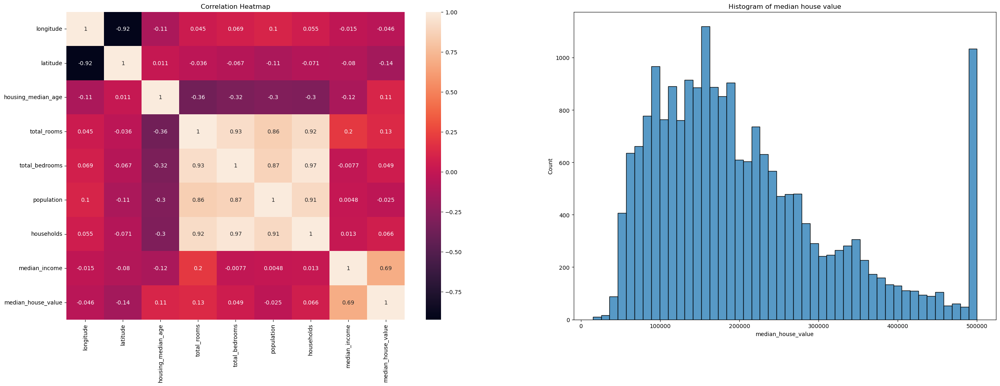

In [16]:
figure, axis = plt.subplots(1, 2, figsize=(30, 10))

sns.heatmap(data.corr(), annot=True, ax=axis[0])
axis[0].set_title("Correlation Heatmap")

sns.histplot(data['median_house_value'], ax=axis[1])
axis[1].set_title("Histogram of median house value")


plt.show()

In [17]:
# Select the columns (removed OP as it's a categorical column )
selected_columns = ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 
                     'total_bedrooms', 'population', 'households', 
                     'median_income', 'median_house_value']

# Create a subset DataFrame with the selected columns
selected_data = data[selected_columns]

# Calculate correlations
correlation_matrix = selected_data.corr()

correlation_matrix

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.000000,-0.924664,-0.108197,0.044568,0.069260,0.099773,0.055310,-0.015176,-0.045967
latitude,-0.924664,1.000000,0.011173,-0.036100,-0.066658,-0.108785,-0.071035,-0.079809,-0.144160
housing_median_age,-0.108197,0.011173,1.000000,-0.361262,-0.318998,-0.296244,-0.302916,-0.119034,0.105623
total_rooms,0.044568,-0.036100,-0.361262,1.000000,0.927253,0.857126,0.918484,0.198050,0.134153
total_bedrooms,0.069260,-0.066658,-0.318998,0.927253,1.000000,0.873910,0.974725,-0.007682,0.049454
population,0.099773,-0.108785,-0.296244,0.857126,0.873910,1.000000,0.907222,0.004834,-0.024650
households,0.055310,-0.071035,-0.302916,0.918484,0.974725,0.907222,1.000000,0.013033,0.065843
median_income,-0.015176,-0.079809,-0.119034,0.198050,-0.007682,0.004834,0.013033,1.000000,0.688075
median_house_value,-0.045967,-0.144160,0.105623,0.134153,0.049454,-0.024650,0.065843,0.688075,1.000000


In [18]:
high_correlation_pairs = correlation_matrix.unstack().sort_values(ascending = False).drop_duplicates()
high_correlation_pairs.head(10)

longitude           longitude         1.000000
total_bedrooms      households        0.974725
total_rooms         total_bedrooms    0.927253
                    households        0.918484
households          population        0.907222
total_bedrooms      population        0.873910
total_rooms         population        0.857126
median_house_value  median_income     0.688075
median_income       total_rooms       0.198050
median_house_value  total_rooms       0.134153
dtype: float64

In [19]:
# high correlation (greater than 0.8)

high_corr_pairs = high_correlation_pairs[high_correlation_pairs>0.8].index[1:]
high_correlation_pairs_list = list(high_corr_pairs)
high_correlation_pairs_list

[('total_bedrooms', 'households'),
 ('total_rooms', 'total_bedrooms'),
 ('total_rooms', 'households'),
 ('households', 'population'),
 ('total_bedrooms', 'population'),
 ('total_rooms', 'population')]

In [20]:
# Create subplot grid using Plotly
fig = sp.make_subplots(rows=2, cols=3)

# Iterate over each subplot and scatter column pair
for i, (col1, col2) in enumerate(high_correlation_pairs_list):
    row_num, col_num = divmod(i, 3)
    scatter = go.Scatter(x=data[col1], y=data[col2], mode='markers', name=f'Trace {i+1}')
    fig.add_trace(scatter, row=row_num+1, col=col_num+1)

    # Update x and y axis titles for each subplot dynamically
    fig.update_xaxes(title_text=f'{col1}', row=row_num+1, col=col_num+1)
    fig.update_yaxes(title_text=f'{col2}', row=row_num+1, col=col_num+1)

fig.update_layout(title_text="High Correlation between variables", showlegend=False, width= 1300)
fig.show()

In [21]:
data.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
0,-122.23,37.88,41,880,129.0,322,126,8.3252,NEAR BAY,452600
1,-122.22,37.86,21,7099,1106.0,2401,1138,8.3014,NEAR BAY,358500
2,-122.24,37.85,52,1467,190.0,496,177,7.2574,NEAR BAY,352100
3,-122.25,37.85,52,1274,235.0,558,219,5.6431,NEAR BAY,341300
4,-122.25,37.85,52,1627,280.0,565,259,3.8462,NEAR BAY,342200


In [22]:
data.describe()


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,419.266592,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,297.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,438.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,643.250000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


# Data Transformation

In [23]:
# Data Standardization

numerical_columns = ['longitude','latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income']

# Standardize the data
scaler = StandardScaler()
df_scaled_array = scaler.fit_transform(data[numerical_columns])
df_scaled = pd.DataFrame(df_scaled_array, columns=numerical_columns)

df_scaled

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
0,-1.327835,1.052548,0.982143,-0.804819,-0.975228,-0.974429,-0.977033,2.344766
1,-1.322844,1.043185,-0.607019,2.045890,1.355088,0.861439,1.669961,2.332238
2,-1.332827,1.038503,1.856182,-0.535746,-0.829732,-0.820777,-0.843637,1.782699
3,-1.337818,1.038503,1.856182,-0.624215,-0.722399,-0.766028,-0.733781,0.932968
4,-1.337818,1.038503,1.856182,-0.462404,-0.615066,-0.759847,-0.629157,-0.012881
...,...,...,...,...,...,...,...,...
20635,-0.758826,1.801647,-0.289187,-0.444985,-0.390860,-0.512592,-0.443449,-1.216128
20636,-0.818722,1.806329,-0.845393,-0.888704,-0.925139,-0.944405,-1.008420,-0.691593
20637,-0.823713,1.778237,-0.924851,-0.174995,-0.126106,-0.369537,-0.174042,-1.142593
20638,-0.873626,1.778237,-0.845393,-0.355600,-0.307379,-0.604429,-0.393753,-1.054583


In [24]:
scaler = MinMaxScaler()
df_normalized_array = scaler.fit_transform(data[numerical_columns])
df_normalized = pd.DataFrame(df_normalized_array, columns=numerical_columns)
df_normalized

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
0,0.211155,0.567481,0.784314,0.022331,0.019863,0.008941,0.020556,0.539668
1,0.212151,0.565356,0.392157,0.180503,0.171477,0.067210,0.186976,0.538027
2,0.210159,0.564293,1.000000,0.037260,0.029330,0.013818,0.028943,0.466028
3,0.209163,0.564293,1.000000,0.032352,0.036313,0.015555,0.035849,0.354699
4,0.209163,0.564293,1.000000,0.041330,0.043296,0.015752,0.042427,0.230776
...,...,...,...,...,...,...,...,...
20635,0.324701,0.737513,0.470588,0.042296,0.057883,0.023599,0.054103,0.073130
20636,0.312749,0.738576,0.333333,0.017676,0.023122,0.009894,0.018582,0.141853
20637,0.311753,0.732200,0.313725,0.057277,0.075109,0.028140,0.071041,0.082764
20638,0.301793,0.732200,0.333333,0.047256,0.063315,0.020684,0.057227,0.094295


In [25]:
fig = px.box(df_scaled, y=numerical_columns, points="all", color='variable')

fig.update_layout(title='Data Distribution After Scaled')
fig.show()

In [26]:
label_mapping = {"<1H OCEAN": 1, "INLAND": 2, "NEAR OCEAN": 3, "NEAR BAY": 4, "ISLAND": 5}

df_scaled['ocean_proximity'] = data['ocean_proximity'].map(label_mapping)
df_normalized['ocean_proximity'] = data['ocean_proximity'].map(label_mapping)
df_scaled

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity
0,-1.327835,1.052548,0.982143,-0.804819,-0.975228,-0.974429,-0.977033,2.344766,4
1,-1.322844,1.043185,-0.607019,2.045890,1.355088,0.861439,1.669961,2.332238,4
2,-1.332827,1.038503,1.856182,-0.535746,-0.829732,-0.820777,-0.843637,1.782699,4
3,-1.337818,1.038503,1.856182,-0.624215,-0.722399,-0.766028,-0.733781,0.932968,4
4,-1.337818,1.038503,1.856182,-0.462404,-0.615066,-0.759847,-0.629157,-0.012881,4
...,...,...,...,...,...,...,...,...,...
20635,-0.758826,1.801647,-0.289187,-0.444985,-0.390860,-0.512592,-0.443449,-1.216128,2
20636,-0.818722,1.806329,-0.845393,-0.888704,-0.925139,-0.944405,-1.008420,-0.691593,2
20637,-0.823713,1.778237,-0.924851,-0.174995,-0.126106,-0.369537,-0.174042,-1.142593,2
20638,-0.873626,1.778237,-0.845393,-0.355600,-0.307379,-0.604429,-0.393753,-1.054583,2


In [27]:
df_normalized

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity
0,0.211155,0.567481,0.784314,0.022331,0.019863,0.008941,0.020556,0.539668,4
1,0.212151,0.565356,0.392157,0.180503,0.171477,0.067210,0.186976,0.538027,4
2,0.210159,0.564293,1.000000,0.037260,0.029330,0.013818,0.028943,0.466028,4
3,0.209163,0.564293,1.000000,0.032352,0.036313,0.015555,0.035849,0.354699,4
4,0.209163,0.564293,1.000000,0.041330,0.043296,0.015752,0.042427,0.230776,4
...,...,...,...,...,...,...,...,...,...
20635,0.324701,0.737513,0.470588,0.042296,0.057883,0.023599,0.054103,0.073130,2
20636,0.312749,0.738576,0.333333,0.017676,0.023122,0.009894,0.018582,0.141853,2
20637,0.311753,0.732200,0.313725,0.057277,0.075109,0.028140,0.071041,0.082764,2
20638,0.301793,0.732200,0.333333,0.047256,0.063315,0.020684,0.057227,0.094295,2


# Model Training


In [28]:
X = df_normalized
y = data['median_house_value']

In [29]:
X = df_normalized.drop(columns='households')
y = data['median_house_value']

In [30]:
X

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,median_income,ocean_proximity
0,0.211155,0.567481,0.784314,0.022331,0.019863,0.008941,0.539668,4
1,0.212151,0.565356,0.392157,0.180503,0.171477,0.067210,0.538027,4
2,0.210159,0.564293,1.000000,0.037260,0.029330,0.013818,0.466028,4
3,0.209163,0.564293,1.000000,0.032352,0.036313,0.015555,0.354699,4
4,0.209163,0.564293,1.000000,0.041330,0.043296,0.015752,0.230776,4
...,...,...,...,...,...,...,...,...
20635,0.324701,0.737513,0.470588,0.042296,0.057883,0.023599,0.073130,2
20636,0.312749,0.738576,0.333333,0.017676,0.023122,0.009894,0.141853,2
20637,0.311753,0.732200,0.313725,0.057277,0.075109,0.028140,0.082764,2
20638,0.301793,0.732200,0.333333,0.047256,0.063315,0.020684,0.094295,2


In [31]:

X_train, X_valid, y_train, y_valid = train_test_split(X,y, train_size=0.8, test_size=0.2, random_state=0)


X_valid, X_test, y_valid, y_test = train_test_split(X_valid, y_valid, test_size=0.5, random_state=0)

# # Train-Test Split
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
# print("X Train shape = {}, X Test shape = {}, y Train shape = {}, y Test shape = {} ".format(X_train.shape, X_test.shape, y_train.shape,y_test.shape ))

In [32]:
y

0        452600
1        358500
2        352100
3        341300
4        342200
          ...  
20635     78100
20636     77100
20637     92300
20638     84700
20639     89400
Name: median_house_value, Length: 20640, dtype: int64

In [33]:
X

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,median_income,ocean_proximity
0,0.211155,0.567481,0.784314,0.022331,0.019863,0.008941,0.539668,4
1,0.212151,0.565356,0.392157,0.180503,0.171477,0.067210,0.538027,4
2,0.210159,0.564293,1.000000,0.037260,0.029330,0.013818,0.466028,4
3,0.209163,0.564293,1.000000,0.032352,0.036313,0.015555,0.354699,4
4,0.209163,0.564293,1.000000,0.041330,0.043296,0.015752,0.230776,4
...,...,...,...,...,...,...,...,...
20635,0.324701,0.737513,0.470588,0.042296,0.057883,0.023599,0.073130,2
20636,0.312749,0.738576,0.333333,0.017676,0.023122,0.009894,0.141853,2
20637,0.311753,0.732200,0.313725,0.057277,0.075109,0.028140,0.082764,2
20638,0.301793,0.732200,0.333333,0.047256,0.063315,0.020684,0.094295,2


# KNN

In [34]:
k = 8
knn = KNeighborsRegressor(n_neighbors=k,p=2)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"R2 score: {r2 * 100:.2f}")
print(f"Mean squared error: {mse:.2f}")
print(f"Mean absolute error: {mae:.2f}")



R2 score: 70.82
Mean squared error: 3751440638.00
Mean absolute error: 41060.70


#  DecisionTree


In [35]:
tree_regression = DecisionTreeRegressor(max_depth= 5)
tree_regression.fit(X_train,y_train)
y_pred = tree_regression.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"R2 score: {r2 * 100:.2f}")
print(f"Mean squared error: {mse:.2f}")
print(f"Mean absolute error: {mae:.2f}")

R2 score: 62.14
Mean squared error: 4866985098.05
Mean absolute error: 49762.36


# LinearRegression

In [36]:
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)

# Model Evaluation
y_pred = linear_model.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"R2 score: {r2 * 100:.2f}")
print(f"Mean squared error: {mse:.2f}")
print(f"Mean absolute error: {mae:.2f}")

R2 score: 63.08
Mean squared error: 4745919989.45
Mean absolute error: 50161.42


# RandomForestRegression

In [37]:
rf_model = RandomForestRegressor(n_estimators=100, random_state=42,max_depth=5, min_samples_split=10, min_samples_leaf=5, max_features=0.8, max_leaf_nodes=50)
rf_model.fit(X_train, y_train)

# Model Evaluation
y_pred = rf_model.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"R2 score: {r2 * 100:.2f}")
print(f"Mean squared error: {mse:.2f}")
print(f"Mean absolute error: {mae:.2f}")

R2 score: 65.98
Mean squared error: 4372566316.51
Mean absolute error: 47384.09


# Gradient Boosting

In [38]:
gb_regressor = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=1, random_state=42)

# Fit the model to the training data
gb_regressor.fit(X_train, y_train)

y_pred = gb_regressor.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"R2 score: {r2 * 100:.2f}")
print(f"Mean squared error: {mse:.2f}")
print(f"Mean absolute error: {mae:.2f}")

R2 score: 61.03
Mean squared error: 5009825079.43
Mean absolute error: 51713.05


# Support vecter machine

In [39]:
svr_regressor = SVR(kernel='linear',gamma='scale', C=155000, epsilon=0.1)

# Fit the model to the training data
svr_regressor.fit(X_train, y_train)

# # Make predictions on the test data
y_pred = svr_regressor.predict(X_test)
r2 = r2_score(y_test,y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"R2 score: {r2 * 100:.2f}")
print(f"Mean squared error: {mse:.2f}")
print(f"Mean absolute error: {mae:.2f}")



R2 score: 61.73
Mean squared error: 4918799346.68
Mean absolute error: 48661.49


# Learning curve

In [40]:
def plot_learning_curve(estimator, X, y, title="Learning Curve"):
    train_sizes, train_scores, test_scores = learning_curve(estimator, X, y, cv=5, scoring='neg_mean_squared_error')

    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    plt.figure(figsize=(8, 6))
    plt.title(title)
    plt.xlabel("Training examples")
    plt.ylabel("Score")

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r", label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g", label="Cross-validation score")

    plt.legend(loc="best")
    plt.show()


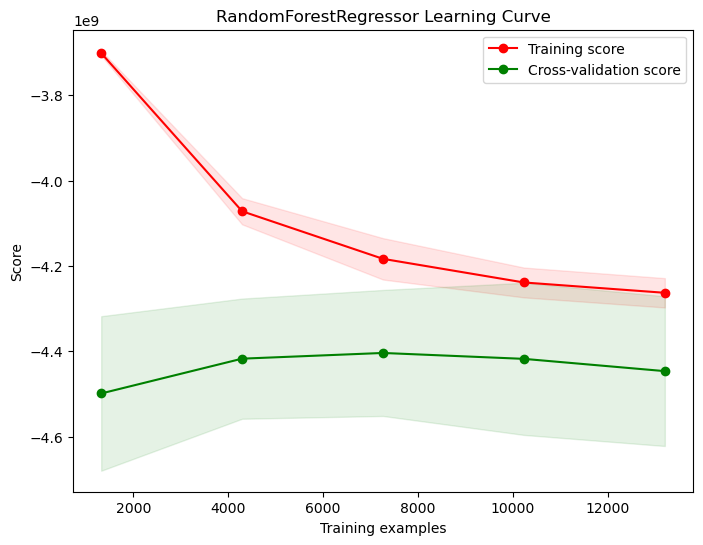

In [41]:
plot_learning_curve(rf_model, X_train, y_train, title="RandomForestRegressor Learning Curve")

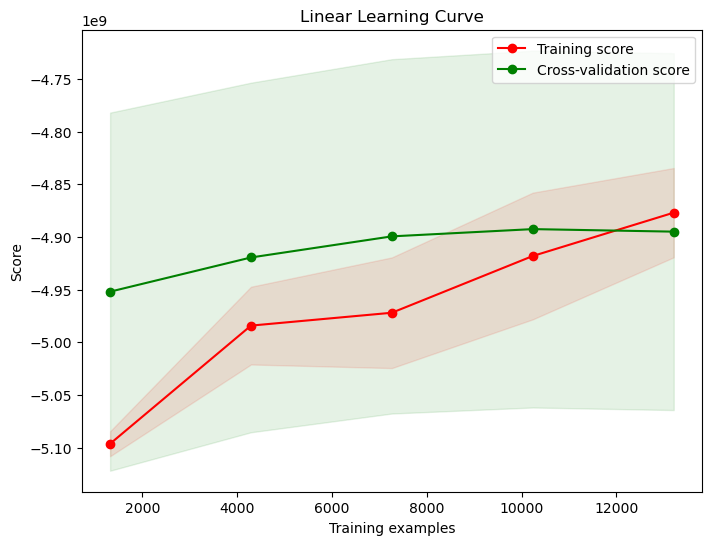

In [42]:
plot_learning_curve(linear_model, X_train, y_train, title="Linear Learning Curve")

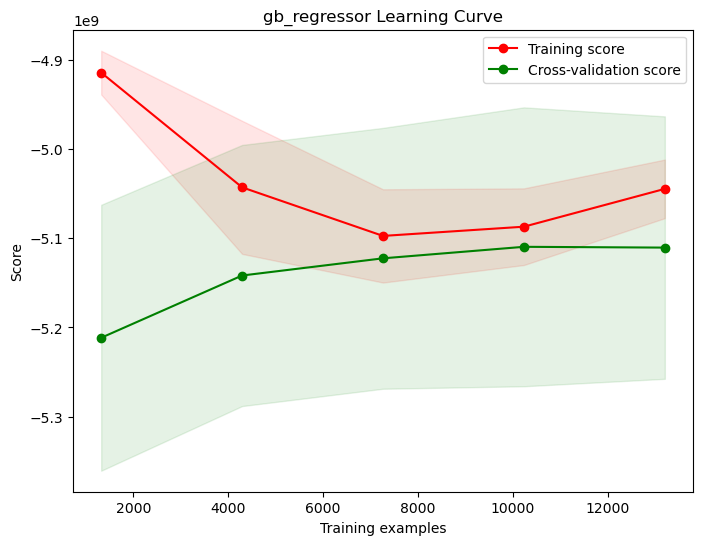

In [43]:
plot_learning_curve(gb_regressor, X_train, y_train, title="gb_regressor Learning Curve")

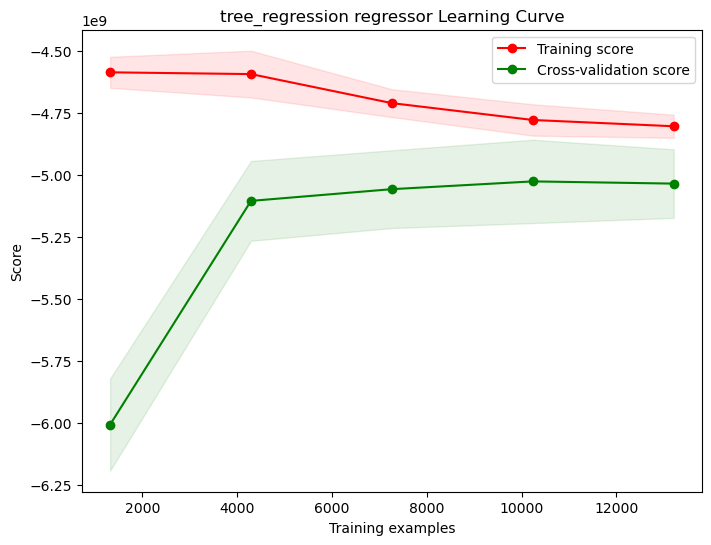

In [44]:
plot_learning_curve(tree_regression, X_train, y_train, title="tree_regression regressor Learning Curve")

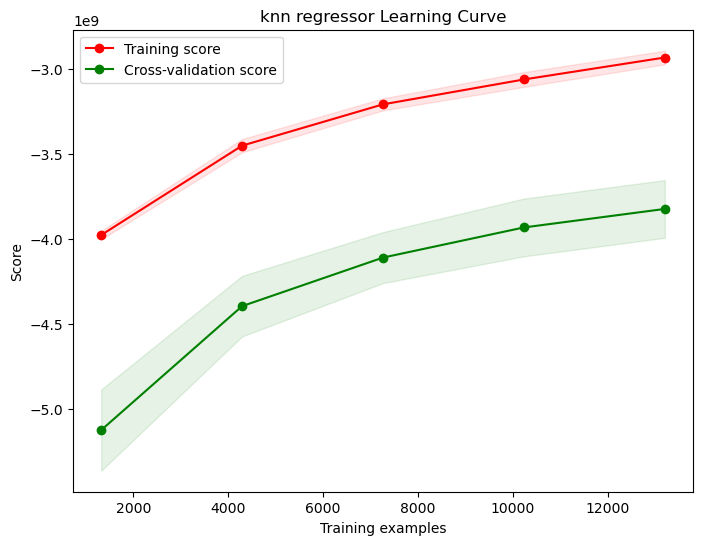

In [45]:
plot_learning_curve(knn, X_train, y_train, title="knn regressor Learning Curve")

In [46]:
# def plot_learning_curve(estimator, title, X, y, axes

In [47]:
# ve_learning_curve (svr_regressorr, X, y)

In [48]:
y_pred

array([ 79258.1741112 ,  31780.28297966, 146886.40681186, ...,
       124385.93006283, 243631.85412587, 180291.47303701])

In [49]:
y_test

12777     60500
13895     54200
7366     169000
11871     87800
19566     93400
          ...  
18719    105000
20483    217700
13048    101900
7772     165000
477      182700
Name: median_house_value, Length: 2064, dtype: int64

# FFNN

Epoch 1/30
413/413 [==============================] - 2s 2ms/step - loss: 54939832320.0000 - mae: 203556.5938 - val_loss: 47969128448.0000 - val_mae: 187315.4844
Epoch 2/30
413/413 [==============================] - 1s 2ms/step - loss: 27850012672.0000 - mae: 127787.1875 - val_loss: 14097053696.0000 - val_mae: 92659.6641
Epoch 3/30
413/413 [==============================] - 1s 2ms/step - loss: 14135297024.0000 - mae: 93799.4453 - val_loss: 13284560896.0000 - val_mae: 91421.0156
Epoch 4/30
413/413 [==============================] - 1s 2ms/step - loss: 13481442304.0000 - mae: 91822.5938 - val_loss: 12680133632.0000 - val_mae: 89191.6172
Epoch 5/30
413/413 [==============================] - 1s 1ms/step - loss: 12862242816.0000 - mae: 89740.3750 - val_loss: 12099070976.0000 - val_mae: 87443.0938
Epoch 6/30
413/413 [==============================] - 1s 1ms/step - loss: 12274713600.0000 - mae: 87786.5469 - val_loss: 11553773568.0000 - val_mae: 85468.6953
Epoch 7/30
413/413 [=================

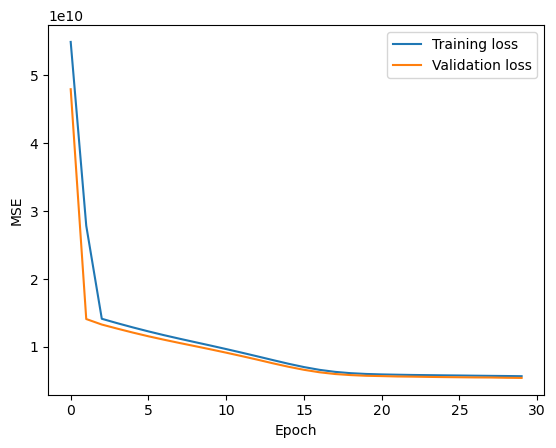

In [50]:
# Xây dựng một Feed Forward Neural Network với 3 lớp ẩn
ffnn = tf.keras.Sequential([
    tf.keras.layers.Dense(64, activation="relu", input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(32, activation="relu"),
    tf.keras.layers.Dense(16, activation="relu"),
    tf.keras.layers.Dropout(0,2),
    tf.keras.layers.Dense(1)
])

# Biên dịch mô hình với hàm mất mát là mean squared error và thuật toán tối ưu là Adam
ffnn.compile(loss="mse", optimizer="adam", metrics=["mae"])
# Thêm EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10)
# Huấn luyện mô hình với 100 epoch và kích thước batch là 32
ffnn_history = ffnn.fit(X_train, y_train, epochs=30, batch_size=32, validation_split=0.2)

# Đánh giá mô hình trên tập kiểm tra
ffnn.evaluate(X_test, y_test)

# Vẽ đồ thị biểu diễn quá trình huấn luyện
plt.plot(ffnn_history.history["loss"], label="Training loss")
plt.plot(ffnn_history.history["val_loss"], label="Validation loss")
plt.xlabel("Epoch")
plt.ylabel("MSE")
plt.legend()
plt.show()



# RNN

Epoch 1/30
413/413 [==============================] - 7s 8ms/step - loss: 56410677248.0000 - mae: 207183.7969 - val_loss: 56009048064.0000 - val_mae: 207443.2031
Epoch 2/30
413/413 [==============================] - 2s 6ms/step - loss: 56404819968.0000 - mae: 207169.6250 - val_loss: 56003481600.0000 - val_mae: 207429.7188
Epoch 3/30
413/413 [==============================] - 3s 7ms/step - loss: 56399265792.0000 - mae: 207156.3594 - val_loss: 55997972480.0000 - val_mae: 207416.5000
Epoch 4/30
413/413 [==============================] - 3s 6ms/step - loss: 56393814016.0000 - mae: 207143.0781 - val_loss: 55992479744.0000 - val_mae: 207403.2500
Epoch 5/30
413/413 [==============================] - 2s 6ms/step - loss: 56388341760.0000 - mae: 207129.8594 - val_loss: 55987015680.0000 - val_mae: 207390.1250
Epoch 6/30
413/413 [==============================] - 2s 6ms/step - loss: 56382861312.0000 - mae: 207116.7500 - val_loss: 55981547520.0000 - val_mae: 207376.8438
Epoch 7/30
413/413 [========

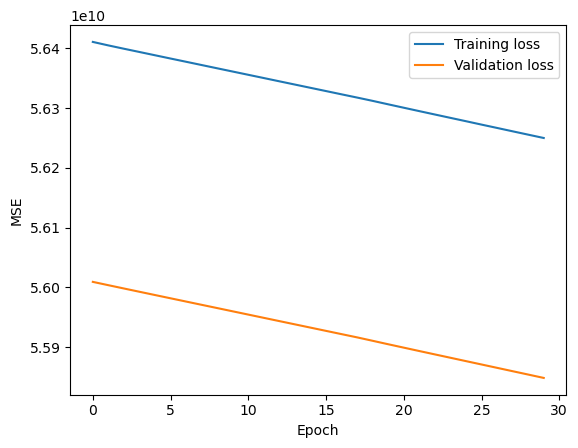

In [51]:
# Xây dựng một Recurrent Neural Network với 2 lớp LSTM
rnn = tf.keras.Sequential([
    tf.keras.layers.LSTM(64, return_sequences=True, input_shape=(X_train.shape[1], 1)),
    tf.keras.layers.LSTM(32),
    tf.keras.layers.Dropout(0,2),
    tf.keras.layers.Dense(1)
])

# Biên dịch mô hình với hàm mất mát là mean squared error và thuật toán tối ưu là Adam
rnn.compile(loss="mse", optimizer="adam", metrics=["mae"])

# Thêm EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10)
# Huấn luyện mô hình với 100 epoch và kích thước batch là 32

rnn_history = rnn.fit(X_train.to_numpy().reshape(-1, X_train.shape[1], 1), y_train, epochs=30, batch_size=32, validation_split=0.2,callbacks=[early_stopping])

# Đánh giá mô hình trên tập kiểm tra

rnn.evaluate(X_test.to_numpy().reshape(-1, X_test.shape[1], 1), y_test)


# Vẽ đồ thị biểu diễn quá trình huấn luyện
plt.plot(rnn_history.history["loss"], label="Training loss")
plt.plot(rnn_history.history["val_loss"], label="Validation loss")
plt.xlabel("Epoch")
plt.ylabel("MSE")
plt.legend()
plt.show()

## so sánh đánh giá


Dựa trên đồ thị bạn đã cung cấp, dưới đây là một số nhận xét về mô hình thứ nhất:

-Giảm thiểu mất mát: Cả mất mát huấn luyện và mất mát xác thực đều giảm đáng kể trong những epoch đầu tiên, cho thấy mô hình đang học nhanh chóng.

-Hội tụ: Sau khoảng mười epoch, cả hai đường đều ổn định, cho thấy mô hình đã hầu như hội tụ.

-Không có overfitting: Mất mát huấn luyện bắt đầu rất cao nhưng nhanh chóng giảm xuống và gần với mất mát xác thực, cho thấy không có hiện tượng overfitting.

## Kỹ thuật tránh overfitting

In [52]:
#Sử dụng Cross-Validation với RandomForest
from sklearn.model_selection import cross_val_score
rf = RandomForestRegressor(n_estimators=100, random_state=42)
scores = cross_val_score(rf, X_train, y_train, cv=5)
print("Điểm trung bình cross-validation: ", scores.mean())

#Regularization với Ridge Regression
ridge = Ridge(alpha=1.0)
ridge.fit(X_train, y_train)
 
#Mạng Neural với Dropout và Early Stopping
model = Sequential([
    Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
    Dropout(0.5),
    Dense(64, activation='relu'),
    Dropout(0.5),
    Dense(1)
])
model.compile(optimizer='adam', loss='mean_squared_error')
early_stopping = EarlyStopping(monitor='val_loss', patience=5)
model.fit(X_train, y_train, epochs=70, validation_split=0.2, callbacks=[early_stopping])


Điểm trung bình cross-validation:  0.8073346661644134
Epoch 1/70
413/413 [==============================] - 1s 2ms/step - loss: 55777189888.0000 - val_loss: 53345312768.0000
Epoch 2/70
413/413 [==============================] - 1s 1ms/step - loss: 47246221312.0000 - val_loss: 37899628544.0000
Epoch 3/70
413/413 [==============================] - 1s 1ms/step - loss: 28720584704.0000 - val_loss: 19579226112.0000
Epoch 4/70
413/413 [==============================] - 1s 1ms/step - loss: 17733844992.0000 - val_loss: 14322950144.0000
Epoch 5/70
413/413 [==============================] - 1s 1ms/step - loss: 15948472320.0000 - val_loss: 13652711424.0000
Epoch 6/70
413/413 [==============================] - 1s 1ms/step - loss: 15561294848.0000 - val_loss: 13344307200.0000
Epoch 7/70
413/413 [==============================] - 1s 1ms/step - loss: 15402388480.0000 - val_loss: 13029111808.0000
Epoch 8/70
413/413 [==============================] - 1s 1ms/step - loss: 14968784896.0000 - val_loss: 127

413/413 [==============================] - 1s 1ms/step - loss: 7784669696.0000 - val_loss: 5679744000.0000
Epoch 70/70
413/413 [==============================] - 1s 1ms/step - loss: 7818524160.0000 - val_loss: 5654339072.0000


## Kỹ thuật cải thiện độ chính xác

In [53]:

#Tinh chỉnh Hyperparameters với GridSearchCV
param_grid = {'n_estimators': [100, 150, 200], 'max_depth': [10, 15, 20]}
grid_search = GridSearchCV(RandomForestRegressor(random_state=42), param_grid, cv=5)
grid_search.fit(X_train, y_train)
print("Các tham số tốt nhất: ", grid_search.best_params_)

# Kỹ thuật Feature Engineering: Thêm các interaction terms
poly = PolynomialFeatures(degree=2, interaction_only=True, include_bias=False)
X_train_poly = poly.fit_transform(X_train)

# Kỹ thuật Ensembling: Kết hợp các mô hình cơ sở
voting_reg = VotingRegressor(estimators=[
    ('rf', RandomForestRegressor(n_estimators=100)),
    ('ridge', Ridge()),
    ('gbr', GradientBoostingRegressor(n_estimators=100))
])
voting_reg.fit(X_train, y_train)

Các tham số tốt nhất:  {'max_depth': 20, 'n_estimators': 200}


VotingRegressor(estimators=[('rf', RandomForestRegressor()), ('ridge', Ridge()),
                            ('gbr', GradientBoostingRegressor())])

## ReEvolution

In [60]:
print('ky thuat tranh overfitting')

y_pred = ffnn.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"FFNN R2 score: {r2 * 100:.2f}")
print(f"FFNN Mean squared error: {mse:.2f}")
print(f"FFNN Mean absolute error: {mae:.2f}")

y_pred = model.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"Neural R2 score: {r2 * 100:.2f}")
print(f"Neural Mean squared error: {mse:.2f}")
print(f"Neural Mean absolute error: {mae:.2f}")

print('-'*30)

y_pred = ridge.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"ridge R2 score: {r2 * 100:.2f}")
print(f"ridge Mean squared error: {mse:.2f}")
print(f"ridge Mean absolute error: {mae:.2f}")

y_pred = svr_regressor.predict(X_test)
r2 = r2_score(y_test,y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"svr_regressor R2 score: {r2 * 100:.2f}")
print(f"svr_regressor Mean squared error: {mse:.2f}")
print(f"svr_regressor Mean absolute error: {mae:.2f}")

print('-'*30)
print('ky thuat cai thien do chinh xac')

print('-'*30)
y_pred = rf_model.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"random forest R2 score: {r2 * 100:.2f}")
print(f"random forest Mean squared error: {mse:.2f}")
print(f"random forest Mean absolute error: {mae:.2f}")

print('-'*30)
y_pred = voting_reg.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"voting_reg R2 score: {r2 * 100:.2f}")
print(f"voting_reg Mean squared error: {mse:.2f}")
print(f"voting_reg Mean absolute error: {mae:.2f}")

y_pred = grid_search.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print(f"grid_search R2 score: {r2 * 100:.2f}")
print(f"grid_search Mean squared error: {mse:.2f}")
print(f"grid_search Mean absolute error: {mae:.2f}")

ky thuat tranh overfitting
65/65 [==============================] - 0s 1ms/step
FFNN R2 score: 56.72
FFNN Mean squared error: 5563418710.09
FFNN Mean absolute error: 54235.71
65/65 [==============================] - 0s 1ms/step
Neural R2 score: 54.84
Neural Mean squared error: 5805085701.02
Neural Mean absolute error: 54816.66
------------------------------
ridge R2 score: 62.58
ridge Mean squared error: 4810416057.42
ridge Mean absolute error: 50608.13
svr_regressor R2 score: 61.73
svr_regressor Mean squared error: 4918799346.68
svr_regressor Mean absolute error: 48661.49
------------------------------
ky thuat cai thien do chinh xac
------------------------------
random forest R2 score: 65.98
random forest Mean squared error: 4372566316.51
random forest Mean absolute error: 47384.09
------------------------------
voting_reg R2 score: 78.13
voting_reg Mean squared error: 2811770335.72
voting_reg Mean absolute error: 36908.85
grid_search R2 score: 82.48
grid_search Mean squared error: 